# Reviews are KING - Project Notebook

#### Team members: Shengzhao LEI - Tao SUN -  Xiangzhe MENG

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None

In [2]:
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
import cufflinks as cf
plotly.tools.set_credentials_file(username='xiangzhe', api_key='Unpa3E5YnUE101VWrS0n')
cf.set_config_file(offline=False, world_readable=True, theme='white')

# 1 - Data preprocessing

## 1.1 - Load Kindle store product data

In [62]:
df_kindle_meta = pd.read_pickle('pickleDataNew/previous_data/kindle_metadata.pkl')
print("After data cleaning, there remains {} kindle store products, all of these products possess at least 5 reviews in reciew dataset.".format(df_kindle_meta.shape[0]))

After data cleaning, there remains 61682 kindle store products, all of these products possess at least 5 reviews in reciew dataset.


We notice that the categories of products in Amazon are hierarchical. And each book may belong to several different categories. So, we need to change the format of categories in our dataset.

The cell below is an example of the category for a product.

In [58]:
df_kindle_meta.iloc[0].categories

[['Books', 'Literature & Fiction'],
 ['Books', 'Mystery, Thriller & Suspense', 'Thrillers & Suspense', 'Suspense'],
 ['Kindle Store', 'Kindle eBooks', 'Mystery, Thriller & Suspense', 'Suspense']]

## 1.2 - Reshape Kindle product and review dataframe by category

Below is the process of reshaping the category information. We want to unzip the hierarchical category in order to analyze the category of each book directly. We find that for all kindle books, the first category must be **Kindle Store** which we don't need.

In [63]:
kindle_cat = []
for idx in df_kindle_meta.index:
    cat = df_kindle_meta.loc[idx].categories
    for catcat in cat:
        if catcat[0]=='Kindle Store':
            kindle_cat.append([idx]+catcat[1:])
        else:
            kindle_cat.append([idx]+catcat)

In [64]:
df_kindle_category = pd.DataFrame(kindle_cat)
df_kindle_category.columns = ['asin','1st','2nd','3rd','4th','5th','6th','7th']
df_kindle_category.set_index('asin',inplace=True)
df_kindle_category.set_index('asin',inplace=True)
df_kindle_category.head()

,1st,2nd,3rd,4th,5th,6th,7th
asin,,,,,,,
B000F83SZQ,Books,Literature & Fiction,None,None,None,None,None
B000F83SZQ,Books,"Mystery, Thriller & Suspense",Thrillers & Suspense,Suspense,None,None,None
B000F83SZQ,Kindle eBooks,"Mystery, Thriller & Suspense",Suspense,None,None,None,None
B000FA64QO,Books,Literature & Fiction,Genre Fiction,Movie Tie-Ins,None,None,None
B000FA64QO,Books,Science Fiction & Fantasy,Science Fiction,Space Opera,None,None,None


Now, let's do some very basic analysis about our category information. Here is a brief description/summary of all the categories present in the dataframe and the number of products for each category.

In [68]:
df_kindle_category['1st'].value_counts()

Kindle eBooks         145691
Books                 143778
Kindle Short Reads     24078
Kindle Singles           338
Kindle Worlds             70
Toys & Games               1
Sports & Outdoors          1
TestNode                   1
Name: 1st, dtype: int64

`1st` column of the dataframe category represents the biggest groups that the book belongs to.

Out of our surprise, besides **Books** and **Kindle eBooks**, there are other categories, like **Kindle Short Reads**, which is very creative and interesting kindle product and we have a large amount of reviews/metadata related to it. We can also do some extra analysis on this category. So, we decide to keep it.

After observing the whole dataframe and the category structure, we decide to use two categories **Books** and **Kindle Short Reads** for our project.

### 1.2.1 - SubCategories of Kindle book products

In this part, we collect all kindle products with category **Books** and classify these products with the sub-categories shown below. The cell give us the number of products for each category as well.

In [41]:
df_kindle_category[df_kindle_category['1st'] == 'Books']['2nd'].value_counts()

Literature & Fiction            47074
Romance                         35096
Science Fiction & Fantasy       10514
Mystery, Thriller & Suspense     9633
Health, Fitness & Dieting        4946
Children's Books                 4590
Cookbooks, Food & Wine           4547
Gay & Lesbian                    4060
Self-Help                        3036
Teen & Young Adult               2758
Business & Money                 2515
Christian Books & Bibles         2483
Religion & Spirituality          2437
Crafts, Hobbies & Home           1569
Reference                        1325
Humor & Entertainment            1106
Biographies & Memoirs            1016
Parenting & Relationships         894
Computers & Technology            752
Travel                            496
History                           488
Education & Teaching              420
Politics & Social Sciences        369
Arts & Photography                366
Medical Books                     353
Sports & Outdoors                 342
Science & Ma

In [82]:
df_cat = pd.DataFrame(df_kindle_category[df_kindle_category['1st'] == 'Books']['2nd'])
df_cat.columns = ['Category']
df_cat_price = pd.merge(pd.DataFrame(df_kindle_meta['price']),df_cat,left_index=True,right_index=True,how='inner')

df_kindle_review = pd.read_pickle('pickleDataNew/previous_data/kindle_review.pkl')
df_kindle_book_review = pd.merge(df_kindle_review, df_cat_price,left_index=True,right_index=True,how='inner')
df_kindle_book_review.head()

,helpful,reviewText,overall,summary,unixReviewTime,price,Category
asin,,,,,,,
B000F83SZQ,"[0, 0]",I enjoy vintage books and movies so I enjoyed ...,5.0,Nice vintage story,2014-05-05,0.0,Literature & Fiction
B000F83SZQ,"[0, 0]",I enjoy vintage books and movies so I enjoyed ...,5.0,Nice vintage story,2014-05-05,0.0,"Mystery, Thriller & Suspense"
B000F83SZQ,"[2, 2]",This book is a reissue of an old one; the auth...,4.0,Different...,2014-01-06,0.0,Literature & Fiction
B000F83SZQ,"[2, 2]",This book is a reissue of an old one; the auth...,4.0,Different...,2014-01-06,0.0,"Mystery, Thriller & Suspense"
B000F83SZQ,"[2, 2]",This was a fairly interesting read. It had ol...,4.0,Oldie,2014-04-04,0.0,Literature & Fiction


### 1.2.2 - SubCategories of Kindle short read products

In this part, we collect all kindle products with category **Kindle Short Reads** and classify these products with these 6 sub-categories shown below. The cell give us the number of products for each category as well.

In [42]:
df_kindle_category[df_kindle_category['1st'] == 'Kindle Short Reads']['2nd'].value_counts()

Two hours or more (65-100 pages)    7742
90 minutes (44-64 pages)            5980
45 minutes (22-32 pages)            3982
One hour (33-43 pages)              3980
30 minutes (12-21 pages)            2001
15 minutes (1-11 pages)              393
Name: 2nd, dtype: int64

In this part, we select all metadata of the kindle short reads product and create a new dataframe **df_kindle_short_read_meta**.

In [69]:
# Collect all kindle short read product asin
asin_kindle_short_read = df_kindle_category[df_kindle_category['1st'] == 'Kindle Short Reads']
asin_kindle_short_read = asin_kindle_short_read.filter(items = ['2nd'], axis = 1)
asin_kindle_short_read = asin_kindle_short_read.reset_index()
asin_kindle_short_read = asin_kindle_short_read.drop_duplicates(subset = 'asin')
asin_kindle_short_read = asin_kindle_short_read.set_index('asin')

# Collect all kindle short read products
df_kindle_short_read_meta = df_kindle_meta.loc[list(asin_kindle_short_read.index)]
df_kindle_short_read_meta = df_kindle_short_read_meta.drop(['categories'],axis = 1)

# Add sub-category for each product
df_kindle_short_read_meta = df_kindle_short_read_meta.merge(asin_kindle_short_read,left_index=True, right_index=True,how="inner")
df_kindle_short_read_meta.columns = ['price','category']

# Merge kindle short read product and review dataframe
df_kindle_review = pd.read_pickle("pickleDataNew/previous_data/kindle_review.pkl")
df_kindle_short_read_review = df_kindle_review.merge(df_kindle_short_read_meta,left_index=True, right_index=True,how="inner")
df_kindle_short_read_review.to_pickle("pickleDataNew/kindle_short_read_review.pkl")
df_kindle_short_read_review.head()

,helpful,reviewText,overall,summary,unixReviewTime,price,category
asin,,,,,,,
B000FBFMVG,"[0, 0]",Really shouldn't have Han Solo on the cover as...,5.0,An interesting short story.,2014-02-15,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[5, 5]",Originally published as an e-book coinciding w...,3.0,Short story featuring everyone's favorite Wookiee,2008-08-25,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 1]",This book was a good idea. I have always wante...,4.0,Great,2013-04-01,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 0]",Great short story. It gives a little more insi...,5.0,Another read,2014-01-02,1.99,Two hours or more (65-100 pages)
B000FBFMVG,"[0, 0]",I love anything with Chewbacca in it. Him and...,5.0,Love It,2013-10-11,1.99,Two hours or more (65-100 pages)


## 1.3 - Update overall by taking helpful rate into consideration

`helpful rate` is very interesting and we want to make use of it. It shows how useful and reliable one's review and rating is. So, we use `helpful rate` to modify the rating information of every review as following:

$$HelpfulRate = \begin{cases}\dfrac{\# Helpful}{\# Voting}& \# Voting \neq 0\\ 1& \# Voting = 0 \end{cases}$$


$$ModifiedRate = \begin{cases}Rate+1& Rate\leq2,HelpfulRate\leq\dfrac{1}{3}\\Rate-1& Rate\geq4, HelpfulRate\leq\dfrac{1}{3}\\Rate& \text{Otherwise}\end{cases}$$

We assume that overall rating is not reasonable if the helpful rate is smaller than 1/3. Thus, if the unreasonable overall is smaller than 2 we add 1 point to the overall. If the unreasonable overall is larger than 4 we substract 1 point to the overall.

We modify all of our rating information for kindle data and book data as well.

##### Kindle short read review

In [70]:
# Divide the column helpful into two parts
# up --> number of helpful votes
# total --> number of total votes
up = df_kindle_short_read_review['helpful'].apply(lambda x: x[0])
total = df_kindle_short_read_review['helpful'].apply(lambda x: x[1])
 
# Compute helpful rate
df_kindle_short_read_review['helpful rate'] = up/total

# Add helful rate column and fill the nan value with 1
df_kindle_short_read_review['helpful rate'] = df_kindle_short_read_review['helpful rate'].fillna(1).map('{:,.2f}'.format)

# Drop helpful column
df_kindle_short_read_review = df_kindle_short_read_review.drop(['helpful'],axis = 1)

# Change data type for overall and helpful rate columns
df_kindle_short_read_review['overall'] = df_kindle_short_read_review['overall'].astype(float)
df_kindle_short_read_review['helpful rate'] = df_kindle_short_read_review['helpful rate'].astype(float)

# Compute new rate
rate = []
for idx in range(df_kindle_short_read_review.shape[0]):
    if df_kindle_short_read_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_short_read_review.iloc[idx]['overall'] >= 4:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'] - 1)
    elif df_kindle_short_read_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_short_read_review.iloc[idx]['overall'] <= 2:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'] + 1)
    else:
        rate.append(df_kindle_short_read_review.iloc[idx]['overall'])
        
# Add rate column        
df_kindle_short_read_review['rate'] = rate

# Drop overall and helpful rate colum
df_kindle_short_read_review = df_kindle_short_read_review.drop(['overall','helpful rate'],axis = 1)

# Reorder columns
df_kindle_short_read_review = df_kindle_short_read_review[['category','rate','price','summary','reviewText','unixReviewTime']]

# Update pickle file
df_kindle_short_read_review.to_pickle("pickleDataNew/kindle_short_read_review.pkl")

##### Kindle book review

In [220]:
# Divide the column helpful into two parts
# up --> number of helpful votes
# total --> number of total votes
up = df_kindle_book_review['helpful'].apply(lambda x: x[0])
total = df_kindle_book_review['helpful'].apply(lambda x: x[1])

# Compute helpful rate
df_kindle_book_review['helpful rate'] = up/total

# Add helful rate column and fill the nan value with 1
df_kindle_book_review['helpful rate'] = df_kindle_book_review['helpful rate'].fillna(1).map('{:,.2f}'.format)

# Drop helpful column
df_kindle_book_review = df_kindle_book_review.drop(['helpful'],axis = 1)

# Change data type for overall and helpful rate columns
df_kindle_book_review['overall'] = df_kindle_book_review['overall'].astype(float)
df_kindle_book_review['helpful rate'] = df_kindle_book_review['helpful rate'].astype(float)

# Compute new rate
rate = []
for idx in range(df_kindle_book_review.shape[0]):
    if df_kindle_book_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_book_review.iloc[idx]['overall'] >= 4:
        rate.append(df_kindle_book_review.iloc[idx]['overall'] - 1)
    elif df_kindle_book_review.iloc[idx]['helpful rate'] <= 1/3 and df_kindle_book_review.iloc[idx]['overall'] <= 2:
        rate.append(df_kindle_book_review.iloc[idx]['overall'] + 1)
    else:
        rate.append(df_kindle_book_review.iloc[idx]['overall'])

        
# Add rate column
df_kindle_book_review['rate'] = rate

# Drop overall and helpful rate colum
df_kindle_book_review = df_kindle_book_review.drop(['overall','helpful rate'],axis = 1)

# Reorder and rename columns
df_kindle_book_review = df_kindle_book_review[['Category','rate','Price','summary','reviewText','unixReviewTime']]
df_kindle_book_review.columns = ['category','rate','price','summary','reviewText','unixReviewTime']

# Update pickle file
df_kindle_book_review.to_pickle("pickleDataNew/kindle_book_review.pkl")

# 2 - Load useful data for data analysis

With this part, one can easily load our clean after-preprocessing dataset.

## 2.1 - Load Kindle short read reviews dataset

In [83]:
df_kindle_short_read_review = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')
df_kindle_short_read_review.head()

,category,rate,price,summary,reviewText,unixReviewTime
asin,,,,,,
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,An interesting short story.,Really shouldn't have Han Solo on the cover as...,2014-02-15
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Short story featuring everyone's favorite Wookiee,Originally published as an e-book coinciding w...,2008-08-25
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Great,This book was a good idea. I have always wante...,2013-04-01
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Another read,Great short story. It gives a little more insi...,2014-01-02
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Love It,I love anything with Chewbacca in it. Him and...,2013-10-11


## 2.2 - Load kindle book reviews dataset

In [78]:
df_kindle_book_review = pd.read_pickle('pickleDataNew/kindle_book_review.pkl')
df_kindle_book_review.head()

,category,rate,price,summary,reviewText,unixReviewTime
asin,,,,,,
B000F83SZQ,Literature & Fiction,5.0,0.0,Nice vintage story,I enjoy vintage books and movies so I enjoyed ...,2014-05-05
B000F83SZQ,Literature & Fiction,4.0,0.0,Different...,This book is a reissue of an old one; the auth...,2014-01-06
B000F83SZQ,Literature & Fiction,4.0,0.0,Oldie,This was a fairly interesting read. It had ol...,2014-04-04
B000F83SZQ,Literature & Fiction,5.0,0.0,I really liked it.,I'd never read any of the Amy Brewster mysteri...,2014-02-19
B000F83SZQ,Literature & Fiction,3.0,0.0,Period Mystery,"If you like period pieces - clothing, lingo, y...",2014-03-19


# 3 - Data analysis 

## 3.1 Kindle Book Store 

### 3.1.1 General Analysis

#### ( a ) From The Perspective of Rating

#### `Topic:` Rating For Each Category

#### Average rating score

In this part we study the average rating score for each category and sort it to find the 'best' and the 'worst' category.

In [108]:
df_book = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')
cat_list = df_book.reset_index().category.unique()
df_year_cat = df_book.reset_index()[['rate','reviewText','year','category']]
df_year = df_year_cat[['year','rate','reviewText']].drop_duplicates()

df_avg_rate = pd.DataFrame(df_book.groupby(['category'])['rate'].mean().round(2))
layout = go.Layout(
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
        type='linear',
        range=[4, 4.65],
        dtick=0.1
    ),
)
data = [go.Bar(
            x=df_avg_rate.index,
            y=df_avg_rate['rate'],
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5']
            ),
            opacity=0.8
        )]
fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link=False)

**`What we have known so far:`**

Interesting! It seems that books related to health and science all have high score. But books about entertainment are difficult to get that good score.

Can we get the conclusion: More scientific, higher the score is? More fun, lower the score is? It's worth further studying.

**Breakdown of rating score**

In this part, we want show the distribution of rating score in each category.

In [109]:
df_rate_count = pd.DataFrame(df_book.groupby(['category','rate'])['rate'].count())
df_rate_count = df_rate_count.unstack()
df_rate_count.columns = ['1 star','2 stars','3 stars','4 stars','5 stars']
df_rate_count['sum'] = df_rate_count['1 star']+df_rate_count['2 stars']+df_rate_count['3 stars']+df_rate_count['4 stars']+df_rate_count['5 stars']
for col in ['1 star','2 stars','3 stars','4 stars','5 stars']:
    df_rate_count[col] = df_rate_count[col]/df_rate_count['sum'] * 100
    df_rate_count[col] = df_rate_count[col].map('{:.2f}'.format)
df_rate_count.sort_values(by = ['5 stars'],inplace = True)
df_rate_count.drop(['sum'],axis=1,inplace=True)

In [110]:
df_rate_count.head()

,1 star,2 stars,3 stars,4 stars,5 stars
category,,,,,
Gay & Lesbian,1.74,3.91,14.19,30.63,49.52
History,2.37,3.87,13.84,29.60,50.32
Romance,1.71,3.57,12.49,29.28,52.95
Humor & Entertainment,3.79,5.44,13.00,24.25,53.52
"Mystery, Thriller & Suspense",1.80,3.84,12.82,28.02,53.52


In [114]:
data = []
for ind, rate in enumerate(df_rate_count.columns):
    data.append(
        go.Bar(
            x=list(df_rate_count.index),
            y=df_rate_count[rate],
            name=rate, 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = 'white',
                    width = 1),
            )
        )
    )

layout = go.Layout(
    barmode='stack',
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    )
)
figure = go.Figure(data=data, layout=layout)
iplot(figure, show_link=False)

**`What we have known so far:`**
1. Most of people love to give 5 star review and only a few reviewer would give 1 star and it is true for each category.
2. **The topic of books somehow influences people's rating?** 

#### `Topic:` Rating For Each Year

In this part we are going to do some basic analysis on the rating score and find how it changes over time.

In [25]:
df_kindle_book_review['year'] = df_kindle_book_review['unixReviewTime'].apply(lambda x: x.year).values

Following are the categories we have for some years. Notice that not all categories exist in each year in our dataset.

In [10]:
df_kindle_book_review[df_kindle_book_review['year'] == 2000]['category'].value_counts()

Literature & Fiction            7
Romance                         6
Mystery, Thriller & Suspense    5
Religion & Spirituality         1
Christian Books & Bibles        1
Name: category, dtype: int64

In [12]:
df_kindle_book_review[df_kindle_book_review['year'] == 2008]['category'].value_counts()

Literature & Fiction            189
Romance                         143
Gay & Lesbian                    23
Mystery, Thriller & Suspense     20
Science Fiction & Fantasy         8
Reference                         8
Religion & Spirituality           1
Humor & Entertainment             1
Arts & Photography                1
Parenting & Relationships         1
Name: category, dtype: int64

**Annual difference on average score**

In [5]:
df_kindle_book_review_with_pred_diff['year'] = df_kindle_book_review_with_pred_diff['unixReviewTime'].apply(lambda x: x.year)
df_avg_score_by_year = pd.DataFrame(df_kindle_book_review_with_pred_diff.groupby(['year'])['rate'].mean())
df_amount_by_year = pd.DataFrame(df_kindle_book_review_with_pred.groupby(['year'])['rate'].count())

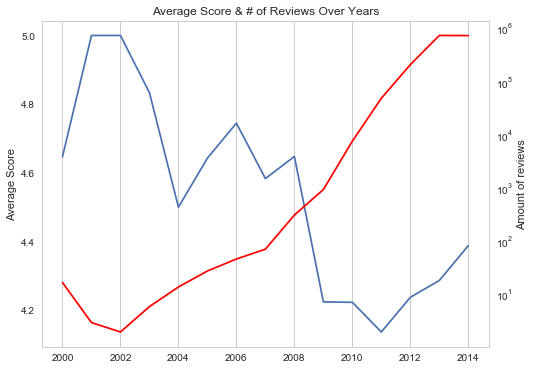

In [47]:
df_book['year'] = df_book['unixReviewTime'].apply(lambda x: x.year)
df_avg_score_by_year = pd.DataFrame(df_book.groupby(['year'])['rate'].mean())
df_amount_by_year = pd.DataFrame(df_book.groupby(['year'])['rate'].count())

fig = plt.figure(figsize=(8,6))
sns.set_style("whitegrid")
# Average Score over year
ax1 = fig.add_subplot(111)
ax1.plot(df_avg_score_by_year)
plt.ylabel("Average Score")
plt.grid(axis='y',b=False)

# Amount of reviews over year
ax2 = ax1.twinx()
plt.semilogy(df_amount_by_year,'r')
plt.ylabel('Amount of reviews')
plt.grid(axis='y',b=False)

plt.title('Average Score & # of Reviews Over Years')
plt.show()

**Annual breakdown of score**

In [121]:
df_year = df_kindle_book_review[['rate','unixReviewTime']]
df_year['year'] = df_year.unixReviewTime.apply(lambda x: x.year)
df_year_break = pd.DataFrame(df_year[df_year.year>=2010].groupby(['year','rate']).rate.count())
df_year_break = df_year_break.unstack()
df_year_break.columns = df_year_break.columns.droplevel(0)
df_year_break.columns = ['1 star','2 stars','3 stars','4 stars','5 stars']
# Calculate Percentage
df_year_break = df_year_break.apply(lambda x: x/x.sum()*100,axis=1)

data = []
for ind, rate in enumerate(df_year_break.columns):
    data.append(
        go.Bar(
            x=list(df_year_break.index),
            y=df_rate_count[rate],
            name=rate, 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = 'white',
                    width = 1),
            )
        )
    )


layout = go.Layout(
    autosize=True,
    title='Rating Breakdown Over Year',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    barmode='stack'
)

figure = go.Figure(data=data, layout=layout)
iplot(figure, show_link=False)

**`What we have known so far:`**
1. The amount of data before 2009 is very small.
2. For average rating, the score of years before 2009 is meaningless. If we only consider rating score before 2009, we can see that the average rating goes higher every year.
3. For breakdown of scores, we merge the year before 2009 together. From the stacked plot, we can see that the distribution doesn't change much. Most of people give high socre. But recently more and more people give 5 stars which explains why the average rating goes higher recently.

#### ( b ) From The Perspective of Review

#### `Topic:` review 长度变化

In [ ]:
# 海

#### `Topic:` review 关键词年度变化

In [63]:
# 海 每年的词云

### 3.1.2 Review Analysis

#### ( a ) Relationship Between Rating and Review

#### `Topic:` Label Review Text - Sentiment Analyzer

We want to find the relationship between our review and our rating. The easiest way is to also give our review text a score which can represents whether it is positive or negative.

`NLTK` is a leading platform for building Python programs to work with human language data. In this project, we are going to use this library as our key tool for language processing.

`SentimentIntensityAnalyzer` is able to give a sentiment intensity score to sentences. The higher the score is, the more positive the sentence is. The score is normalized to a range of values between -1 and 1. In order to make it comparable with our 1-5 rate, we use linear transformation which linearly maps $(-1,1)$ to $(1,5)$:

$$reviewScoreNorm = 2\times reviewScore+3$$

We can use `reviewScoreNorm` as our predicted rate for each product.

And we calculate the difference score:

$$Diff = \left|reviewScoreNorm-Rate\right|$$

In [68]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
# Score Calculator
sid = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/suntao/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Calculate `reviewScoreNorm` and `predDiff`.

In [74]:
df_review = df_kindle_book_review[['reviewText']]
df_review = df_review.drop_duplicates(subset = 'reviewText')

# Apply score calculator on each entry.
df_review['reviewScore'] = df_review['reviewText'].apply(lambda x: sid.polarity_scores(x)['compound'])

# Merge and Reset Index
df_kindle_book_review_with_pred = pd.merge(df_kindle_book_review, df_review.reset_index(), left_on='reviewText', right_on='reviewText', how='inner')
df_kindle_book_review_with_pred = df_kindle_book_review_with_pred.set_index('asin')

# Normalize the Score
df_kindle_book_review_with_pred['reviewScoreNorm'] = df_kindle_book_review_with_pred[['reviewScore']] * 2 + 3

df_kindle_book_review_with_pred.reset_index(inplace = True)
df_kindle_book_review_with_pred.set_index('category',inplace = True)
df_kindle_book_review_with_pred.sort_index(inplace = True)

# Calculate the difference
df_kindle_book_review_with_pred['predDiff'] = abs(df_kindle_book_review_with_pred['rate'] - df_kindle_book_review_with_pred['reviewScoreNorm']) 

df_kindle_book_review_with_pred.head()

,asin,rate,price,summary,reviewText,unixReviewTime,year,reviewScore,reviewScoreNorm,predDiff
category,,,,,,,,,,
Arts & Photography,B007SNRHSU,2.0,4.99,Short and sweet,A very short tutorial on posing subjects. Whil...,2013-09-27,2013,-0.0534,2.8932,0.8932
Arts & Photography,B00AKXVD1C,2.0,2.99,Didn't finish it,"Sorry, this wasn't what I expected or wanted. ...",2012-12-26,2012,0.4404,3.8808,1.8808
Arts & Photography,B00AKXVD1C,5.0,2.99,A real eye-opener,I have a large collection of photos of friends...,2013-09-12,2013,0.9881,4.9762,0.0238
Arts & Photography,B00AKXVD1C,5.0,2.99,Full of useful information,As a beginner photographer I have found the in...,2013-06-11,2013,0.9516,4.9032,0.0968
Arts & Photography,B00B4I8BX0,4.0,0.99,Very nice!,Colorful and high impact pictures and quotes. ...,2013-11-08,2013,0.8997,4.7994,0.7994


In [76]:
df_kindle_book_review_with_pred.to_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')

#### `Analysis:`

In [77]:
df_kindle_book_review_with_pred = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')

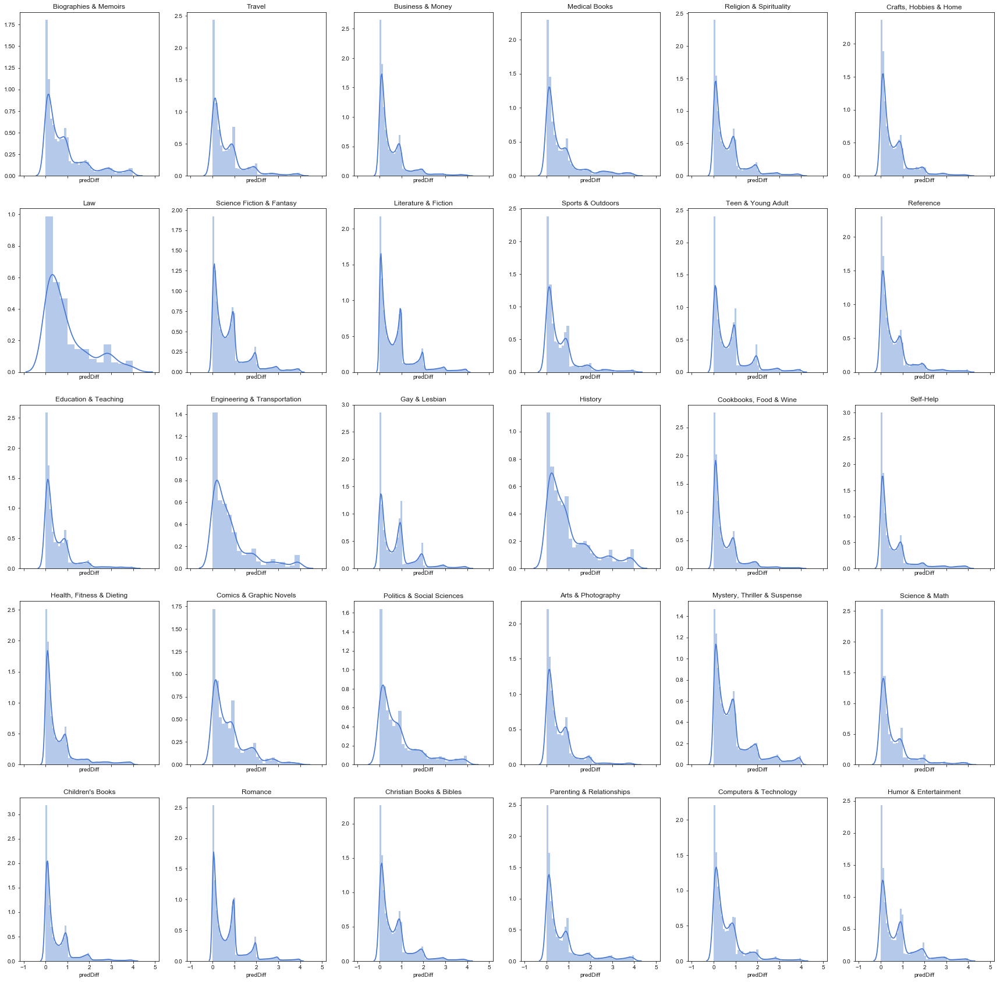

In [75]:
categories = list(set(df_kindle_book_review_with_pred.index))
categories_matrix = np.array(categories).reshape(5,6)
f, axes = plt.subplots(5, 6, figsize=(30,30), sharex=True)
sns.set(style="white", palette="muted", color_codes=True)
for i in range(5):
    for j in range(6):
        axes[i,j].set_title(categories_matrix[i,j])
        sns.distplot(df_kindle_book_review_with_pred[df_kindle_book_review_with_pred.index == categories_matrix[i,j]]['predDiff'], color="b",ax=axes[i,j])

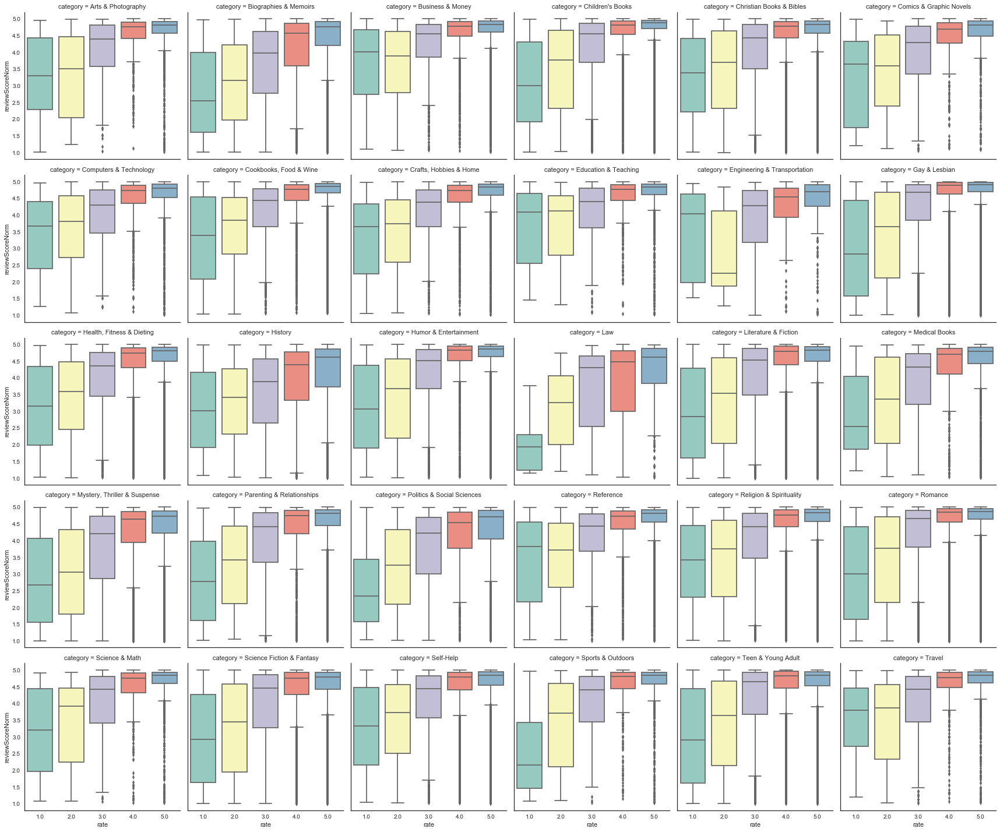

In [78]:
sns.factorplot(x='rate', 
               y='reviewScoreNorm', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='box',
               palette="Set3")

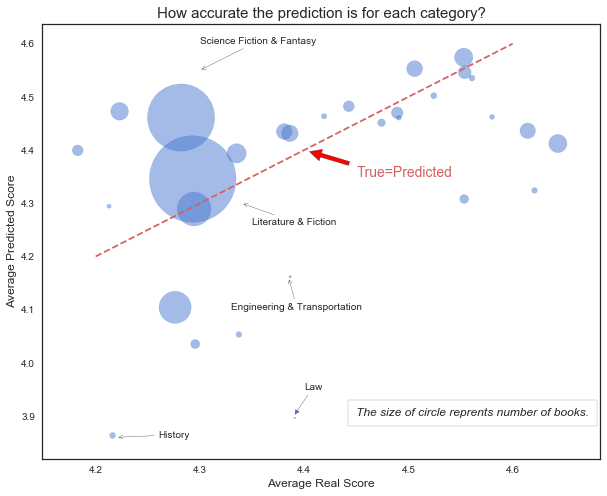

In [95]:
df_re = pd.DataFrame()
df_re['amount'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['rate'].count()
df_re['real_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['rate'].mean()
df_re['pred_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred.index])['reviewScoreNorm'].mean()

f, ax = plt.subplots(1, 1, figsize=(10,8))
ax.scatter(df_re.real_avg, df_re.pred_avg, s=df_re.amount/100, alpha=0.5)
ax.set_xlabel('Average Real Score',fontdict=dict(size=12))
ax.set_ylabel('Average Predicted Score',fontdict=dict(size=12))
ax.set_title('How accurate the prediction is for each category?',fontdict=dict(size=15))

ax.text(4.45, 3.9, 'The size of circle reprents number of books.', style='oblique', fontdict=dict(size=12),
        bbox={'facecolor':'white', 'alpha':0.5, 'pad':8})

# Plot the line where True Score = Predicted Score
ax.plot([4.2,4.6],[4.2,4.6],'r--')
ax.annotate('True=Predicted', size=14, color='r', xy=(4.4, 4.4), xytext=(4.45, 4.35),
            arrowprops=dict(facecolor='red',shrink=0.1))

# Annotate several categories whose difference between true and predicted scores is huge

# Two categories of the smallest amount
# Law
ax.annotate('Law', size=10, xy=(4.39,3.9), xytext=(4.4, 3.95),
            arrowprops=dict(arrowstyle='-|>'))

# Engineering & Transportation
ax.annotate('Engineering & Transportation', size=10, xy=(4.385,4.16), xytext=(4.33, 4.10),
           arrowprops=dict(arrowstyle='->'))

# Two categories of the largest amount
# Literature & Fiction
ax.annotate('Literature & Fiction', size=10, xy=(4.34,4.3), xytext=(4.35, 4.26),
            arrowprops=dict(arrowstyle='->'))

# Science Fiction & Fantasy
ax.annotate('Science Fiction & Fantasy', size=10, xy=(4.3,4.55), xytext=(4.3, 4.6),
            arrowprops=dict(arrowstyle='->'))

# History
ax.annotate('History', size=10, xy=(4.22,3.86), xytext=(4.26, 3.86),
            arrowprops=dict(arrowstyle='->'))

plt.show()

**`What we have known so far:`**
1. We give each review text a sentiment score and normalize it to our 1-5 score as our predicted score, and then we compare it with the real score.
2. From the **Distribution plot of Difference**, we can see that the predicted score is really good since the difference for most of category is small.
3. From the **Volin/Box plot for real v.s. predictive rating score by category**, we can get that for each category high real score will get a high predicted score. In other words, if someone gives high rate then his/her review is more like to have lots of positive words.
4. From the **Scatterplot**, we see that predicted scores of thoes categories of large amount is more accurate which seems to make sense because we have a larger amount of samples.

#### `Topic:` Count Punctuation and Part of Speech
What’s the style of each rating groups of reviewers? To explain this, for each rating, we calculate the average percentage of adjective, adverb, noun, verb as well as exclamation point and question mark which are both highly relevant with people’s feelings. And then scale them to 0-1 for comparing.

In [96]:
df_data_array = []
df_data_array.append(pd.read_pickle('data_rate/data_book_rate1'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate2'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate3'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate4'))
df_data_array.append(pd.read_pickle('data_rate/data_book_rate5'))

In [97]:
# Calculate the percentage of usage of each type of words
def get_info(df):
    df_info=pd.DataFrame()
    df_info['Adj']  = df['Adj']/df['length of review']
    df_info['Adv']  = df['Adv']/df['length of review']
    df_info['Noun'] = df['Noun']/df['length of review']
    df_info['Verb'] = df['Verb']/df['length of review']
    df_info['Signal_ex'] = df['Signal_ex']/df['length of review']
    df_info['Signal_qu'] = df['Signal_qu']/df['length of review']
    return df_info.apply(np.mean,axis=0)

In [122]:
df_all = pd.DataFrame()
for ind, df in enumerate(df_data_array):
    df_all[ind+1]=get_info(df)

# Treat the max as 1 to scale all percentage into 0-1
df_all = df_all.apply(lambda x: (x/x.max()),axis=1)
df_all = df_all.round(2)
df_all.index = ['Adj','Adv','Noun','Verb','Ex - !','Q - ?']

data = []
for ind, rate in enumerate([1,2,3,4,5]):
    data.append(
        go.Bar(
            x=list(df_all.index),
            y=df_all[rate],
            name='Rate '+str(rate), 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = (color_list[ind]),
                    width = 3),
            )
        )
    )
layout = go.Layout(
    autosize=True,
    title='Relative Weight of Each Type',
)
fig = go.Figure(data=data,layout=layout)
iplot(fig,show_link=False)

Use Polar Plot to show the difference in another way.

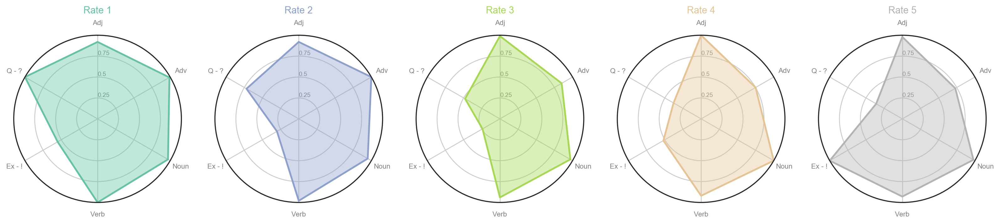

In [105]:
from math import pi

# ------- PART 1: Define a function that do a plot for one line of the dataset!
 
def make_spider( col, title, color):
 
    # number of variable
    categories=list(df_all.index)
    N = len(categories)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    # Initialise the spider plot
    ax = plt.subplot(1,5,col+1, polar=True, )

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='grey', size=8)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.25,0.5,0.75], ["0.25","0.5","0.75"], color="grey", size=7)
    plt.ylim(0,1)

    # Ind1
    values=df_all[col+1].values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=11, color=color, y=1.1)

# ------- PART 2: Apply to all individuals
# initialize the figure
plt.figure(figsize=(20,10),dpi=200)
# Create a color palette:
my_palette = plt.cm.get_cmap("Set2", len(df_all.columns))
 
# Loop to plot
for col in range(0, len(df_all.columns)):
    make_spider(col=col, title='Rate '+ str(df_all.columns[col]), color=my_palette(col))

#### `What we have known so far:` 

1. For **exclamation point**, 5-star reviewers love to use it.
2. For **question mark**, 1-star reviewers love to use it. 
3. For **adverb**, the lower the score is, the more the adverb is. 
4. For **adjective and verb**, high score group use more adjectives while low score group like to use more verbs. 
5. For **noun**, the difference is not that clear.


#### `Topic:` Sentiment Analysis with Machine Learning

In [ ]:
# 孟

#### ( b ) Relationship between category and review

#### `Topic:` 各种类评论数量 平均长度分布

In [ ]:
# 海

#### `Topic:`  6类关键词词云

In [ ]:
# 海

### 3.1.3 Summary Generation

In [ ]:
# TBD

## 3.2 Kindle Short Reads

Arising from 2014, Short Reads now takes up almost one quarter of all available English Kindle titles on Kindle market.

There have been a lot of discussions on the topics of short reads, the book page lengths as well as the price. Let’s have a look at some recent opinions and facts.

In [2]:
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.tools as tls

#plotly.tools.set_credentials_file(username='st999', api_key='2bMT3Kc1zBj4uWPyr4hE')
plotly.tools.set_credentials_file(username='st714', api_key='B2UtPvMC6jOYdJxrceH5')

import cufflinks as cf
cf.set_config_file(offline=True, world_readable=True, theme='white')
color='YlGnBu'
color_list = ['rgb(199, 233, 180)','rgb(127, 205, 187)','rgb(65, 182, 196)',
              'rgb(29, 145, 192)','rgb(34, 94, 168)','rgb(37, 52, 148)']

In [5]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [6]:
df_short = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')

In [7]:
cat_list = ['15 minutes (1-11 pages)','30 minutes (12-21 pages)',
            '45 minutes (22-32 pages)','One hour (33-43 pages)',
            '90 minutes (44-64 pages)','Two hours or more (65-100 pages)']

### 3.2.1 Rating Study

**`OPINION`: Nowadays, reader loves short reads?**

In this part, we are going to expolre whether this is opinion holds.

**`FACT-1`: From the Perspective of Year** 

In [8]:
df_short['year'] = df_short['unixReviewTime'].apply(lambda x: x.year)
df_short_rating = df_short.reset_index().groupby(['category','year']).rate.agg([np.count_nonzero,np.mean,np.median])
df_short_rating.columns = ['#review', 'avg_rate','med_rate']
df_short_rating.head(6)

#review  avg_rate  med_rate
category                year                             
15 minutes (1-11 pages) 2009      5.0  4.000000       4.0
                        2010      4.0  4.750000       5.0
                        2011    287.0  3.909408       4.0
                        2012    662.0  4.010574       4.0
                        2013   1217.0  4.029581       4.0
                        2014    651.0  4.096774       5.0

**There are only a few reviews/rates before 2011. So, we only consider reviews/rates after 2011.**

In [9]:
df_short_rating.reset_index(inplace=True)
df_short_rating = df_short_rating[df_short_rating.year>=2011]
df_short_rating.set_index('category', inplace=True)
df_short_rating.head()

,year,#review,avg_rate,med_rate
category,,,,
15 minutes (1-11 pages),2011,287.0,3.909408,4.0
15 minutes (1-11 pages),2012,662.0,4.010574,4.0
15 minutes (1-11 pages),2013,1217.0,4.029581,4.0
15 minutes (1-11 pages),2014,651.0,4.096774,5.0
30 minutes (12-21 pages),2011,924.0,3.984848,4.0


**Number of Review + Average Rating Over Year **

In [56]:
fig = tls.make_subplots(rows=1, cols=2, shared_xaxes=True, subplot_titles=('Number of Review','Average Rating'))

for ind, cat in enumerate(cat_list):
    fig.append_trace(
        go.Scatter(
            x=[2011,2012,2013,2014],
            y=df_short_rating.loc[cat]['#review'].values,
            name=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
            legendgroup=cat,
        ),
        1,1
    )
    fig.append_trace(
        go.Scatter(
            x=[2011,2012,2013,2014],
            y=df_short_rating.loc[cat].avg_rate.values.round(2),
            name=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
            showlegend = False,
            legendgroup=cat,
        ),
        1,2
    )
    
fig.layout['legend']=dict(
    orientation="h", 
    y=1.2,
    font=dict(
        size=7,
    ),
)

iplot(fig, show_link=False)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



**`DESCRIPTION:`**

Reader satisfaction, as expressed by book review ratings increases with the length of the book; conversely, average ratings drop the shorter the book — at least in the Short Reads segment. So does the sales of books, which are roughly approximated by the number of reviews collected in the dataset.

**`FACT-2`: From the Perspective of Category** 

In [28]:
df_short_rate_distri = df_short.groupby(['category','rate']).count().price
df_short_rate_distri = pd.DataFrame(df_short_rate_distri)
df_short_rate_distri = df_short_rate_distri.unstack(level=0)
df_short_rate_distri.columns = df_short_rate_distri.columns.droplevel(0)
# Calculate Percentage
df_short_rate_distri = df_short_rate_distri/df_short_rate_distri.sum()*100
df_short_rate_distri = df_short_rate_distri.T
df_short_rate_distri = df_short_rate_distri.round(2)
df_short_rate_distri

rate,1.0,2.0,3.0,4.0,5.0
category,,,,,
15 minutes (1-11 pages),4.49,5.91,17.41,26.54,45.65
30 minutes (12-21 pages),2.99,5.04,13.42,26.16,52.38
45 minutes (22-32 pages),2.07,3.66,10.35,23.39,60.53
90 minutes (44-64 pages),1.95,3.52,11.43,25.69,57.41
One hour (33-43 pages),2.02,3.63,10.04,24.25,60.06
Two hours or more (65-100 pages),1.56,3.14,11.67,26.84,56.79


In [49]:
data = []
for ind, rate in enumerate([1,2,3,4,5]):
    data.append(
        go.Bar(
            x=['15 min','30 min', '45 min', '90 min', '1 hour', '2 hours'],
            y=df_short_rate_distri[rate],
            name='Rate '+str(rate), 
            marker = dict(
                color = (color_list[ind]),
                line = dict(
                    color = (color_list[ind]),
                    width = 3),
            )
        )
    )
layout = go.Layout(
    autosize=True,
    title='Rating Breakdown of Short Read',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        type='linear',
        range=[1, 100],
        dtick=20,
        ticksuffix='%'
    ),
    barmode='stack'
)
fig = go.Figure(data=data,layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

As what we have learnt from the book store, most of the reviewers are all very kind to give 4 or 5 star and only less than a quarter of them score the book three star or even lower. However, despite of this general truth, 15-minutes short reads are also not that welcomed with only less than a half of ratings of 5 star.

**`CONCLUSION:`**
   
**Q: Nowadays, reader loves short reads?**

**A: Not Really.**


### 3.2.2 Length of Review Study

**`OPINION`: Short reads leads to short review? **

In this part, we are going to expolre whether this is opinion holds.

In [54]:
df_short_review = df_short.reset_index()[['category','rate','reviewText']]
# Calculate the Review Length
df_short_review['reviewLen'] = df_short_review.reviewText.apply(lambda x: len(x.split(' ')))
df_short_review.head()

,category,rate,reviewText,reviewLen
0,Two hours or more (65-100 pages),5.0,Really shouldn't have Han Solo on the cover as...,35
1,Two hours or more (65-100 pages),3.0,Originally published as an e-book coinciding w...,282
2,Two hours or more (65-100 pages),3.0,This book was a good idea. I have always wante...,42
3,Two hours or more (65-100 pages),5.0,Great short story. It gives a little more insi...,21
4,Two hours or more (65-100 pages),5.0,I love anything with Chewbacca in it. Him and...,28


**`FACT-1`: Length Distribution** 

In [55]:
df_short_review_len = df_short_review.set_index(['category'])[['rate','reviewLen']]
df_short_review_len.sort_values(by='rate',inplace=True,ascending=True)

data = []
for ind,cat in enumerate(cat_list):
    data.append(
        go.Box(
            x=df_short_review_len.loc[cat].rate.values,
            y=df_short_review_len.loc[cat].reviewLen.values,
            name=cat,
            marker = dict(color=(color_list[ind]))
        )
    )

layout = go.Layout(
    title='Length of Review Distribution',
    titlefont=dict(
        size=20
    ),
    yaxis=dict(
        title='Length of Review',
        range=[0,2000],
        zeroline=False
    ),
    boxmode='group',
    legend=dict(
        orientation="h", 
        y=1.1,
        font=dict(
            size=5,
        ),
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

As the length of the book increases, there are going to be more and more active and “serious” reviewers who wrote extreme long reviews. People love to write longer review after finishing longer readings, which of course makes senses.

**`FACT-2`: Mean And Median Study** 

In [53]:
df_short_review_len_mean = df_short_review_len.reset_index().groupby(['category','rate']).mean()
df_short_review_len_mean.reset_index(inplace=True)
df_short_review_len_mean.set_index('category',inplace=True)

df_short_review_len_med = df_short_review_len.reset_index().groupby(['category','rate']).median()
df_short_review_len_med.reset_index(inplace=True)
df_short_review_len_med.set_index('category',inplace=True)

fig = tls.make_subplots(rows=1, cols=2, shared_xaxes=True, subplot_titles=('Average Length','Median Length'))

for ind, cat in enumerate(cat_list):
    fig.append_trace(
        go.Scatter(
            x=df_short_review_len_mean.loc[cat].rate.values,
            y=df_short_review_len_mean.loc[cat].reviewLen.values.round(2),
            name=cat,
            legendgroup=cat,
            line = dict(
                color = (color_list[ind]),
                width = 3),
        ),
        1,1
    )
    fig.append_trace(
        go.Scatter(
            x=df_short_review_len_med.loc[cat].rate.values,
            y=df_short_review_len_med.loc[cat].reviewLen.values,
            name=cat,
            legendgroup=cat,
            showlegend = False,
            line = dict(
                color = (color_list[ind]),
                width = 3),
        ),
        1,2
    )
    
fig.layout['legend']=dict(
    orientation="h", 
    y=1.2,
    font=dict(
        size=7,
    ),
)

iplot(fig, show_link=False)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



**`DESCRIPTION:`**

Longer reads does lead to longer review. But, the mean length is much longer than median length and the difference of the median is not that clear as that of mean.

**`CONCLUSION:`**
   
**Q: Short reads leads to short review??**

**A: Sounds Right.**

### 3.2.3 Price Study

**`OPINION:` Price plays an important role?**

In this part, we are going to expolre whether this is opinion holds.

In [14]:
df_short_price = df_short[df_short.year>=2012][['rate','price','year']]
df_price = df_short_price.reset_index()[['asin','price']].drop_duplicates()

In [15]:
df_price.price.value_counts().sort_values(ascending=False).head(10)

2.99    4636
0.99    4270
0.00    2339
3.99    1352
4.99     632
1.99     582
9.99     418
5.99     246
6.95     245
7.99     191
Name: price, dtype: int64

In [16]:
pd.Series(df_price.price.value_counts().index.values).describe()

count    445.000000
mean       7.802944
std        5.368220
min        0.000000
25%        3.960000
50%        6.870000
75%        9.970000
max       39.990000
dtype: float64

In [17]:
price_labels = ['0-1', '1-2', '2-3', '3-4', '4-5', '5-6', '6-7', '7-8','8-9','9-10','>10']
price_range = [0,1,2,3,4,5,6,7,8,9,10,np.inf]
df_price['price_group'] = pd.cut(df_price.price, price_range, right=True, labels=price_labels)
df_short_price['price_group'] = pd.cut(df_short_price.price, price_range, right=True, labels=price_labels)

**`FACT-1:` Price vs Rating**

In [23]:
trace1=go.Bar(
    x=list(df_price.groupby(['price_group']).size().index),
    y=df_price.groupby(['price_group']).size().values,
    name='Num of Reads',
    marker=go.Marker(color='#0175D8')
)
trace2=go.Scatter(
    x=list(df_short_price.groupby(['price_group']).mean().index),
    y=df_short_price.groupby(['price_group']).mean().rate.values.round(2),
    name='Average Rating',
    yaxis='y2',
    line = dict(
        color = ('#C30C18'),
        width = 3)
)
data=[trace1,trace2]
layout=go.Layout(
    title='Price/Rating of Short Reads',
    titlefont=dict(
        size=20
    ),
    xaxis=dict(
        title='Price'
    ),
    yaxis=dict(
        title='Number of Short Reads',
        showgrid=False,
    ),
    yaxis2=dict(
        title='Average Rating',
        overlaying='y',
        showgrid=False,
        side='right'
    ),
    legend=dict(
        orientation="h", 
        x=.7,
        y=1.1,
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

Higher price results in higher score, which is a little doubtable conclusion as we have fewer data in high price groups. But, one thing is for sure, low price does not lead to high average ratings, and people maybe are more care about the value of books not only the value of money.

**`FACT-2`: Price vs Review**

In [60]:
df_short['price_group'] = pd.cut(df_short.price, price_range, right=True, labels=price_labels)
df_short_review_price = df_short.reset_index()[['price_group','reviewText']]
df_short_review_price['reviewLen'] = df_short_review_price.reviewText.apply(lambda x: len(x.split(' ')))

In [61]:
trace1=go.Bar(
    x=list(df_short_review_price.groupby('price_group').size().index),
    y=df_short_review_price.groupby('price_group').size().values,
    name='Numer of Reviews',
    marker=go.Marker(color='#0175D8'),
)
trace2=go.Scatter(
    x=list(df_short_review_price.groupby('price_group').reviewLen.median().index),
    y=df_short_review_price.groupby('price_group').reviewLen.median().values.round(2),
    name='Median Length',
    yaxis='y2',
    line = dict(
        color = ('#C30C18'),
        width = 3),
)
data=[trace1,trace2]
layout=go.Layout(
    title='Reviews of Short Reads',
    titlefont=dict(
        size=20
    ),
    xaxis=dict(
        title='Price'
    ),
    yaxis=dict(
        title='Number of Reviews',
        showgrid=False,
    ),
    yaxis2=dict(
        title='Median Length of Reviews',
        overlaying='y',
        showgrid=False,
        side='right'
    ),
    legend=dict(
        orientation="h", 
        x=.7,
        y=1.1,
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig,show_link=False)

**`DESCRIPTION:`**

From the perspective of median length of review, lower price leads to shorter length of reviews and in general the reviewers are willing to write long review for high price. But, after all, there are always personal influences behind it. We cannot draw any easy conclusion here.

**`CONCLUSION:`**

**Q: Price plays an important role?**

**A: It's tricky to answer.**

---

# Below is Old Version and 小海的东西需要挪上来

### 3.1 Score review text

We want to find the relationship between our review and our rating. The easiest way is to also give our review text a score which can represents whether it is positive or negative.

`NLTK` is a leading platform for building Python programs to work with human language data. In this project, we are going to use this library as our key tool for language processing.

`SentimentIntensityAnalyzer` is able to give a sentiment intensity score to sentences. The higher the score is, the more positive the sentence is. The score is normalized to a range of values between -1 and 1. In order to make it comparable with our 1-5 rate, we use linear transformation which linearly maps $(-1,1)$ to $(1,5)$:
$$reviewScoreNorm = 2\times reviewScore+3$$
We can use `reviewScoreNorm` as our predicted rate for each product.

And we calculate the difference score:
$$Diff = |reviewScoreNorm-Rate|$$

In [29]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/suntao/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [30]:
sid = SentimentIntensityAnalyzer()

# Collect all reviews and drop duplicates
df_review = df_kindle_book_review[['reviewText']]
df_review = df_review.drop_duplicates(subset = 'reviewText')

# Apply score calculator on each entry with nltk sentiment analysis analyzer
df_review['reviewScore'] = df_review['reviewText'].apply(lambda x: sid.polarity_scores(x)['compound']).values
df_kindle_book_review_with_pred = pd.merge(df_kindle_book_review, df_review.reset_index(), left_on='reviewText', right_on='reviewText', how='inner')
df_kindle_book_review_with_pred = df_kindle_book_review_with_pred.set_index('asin')

# Normalize score
df_kindle_book_review_with_pred['reviewScoreNorm'] = df_kindle_book_review_with_pred[['reviewScore']] * 2 + 3

# Set category as index
df_kindle_book_review_with_pred.reset_index(inplace = True)
df_kindle_book_review_with_pred.set_index('category',inplace = True)

# Calculate the difference between real score and predicted score
df_kindle_book_review_with_pred['predDiff'] = abs(df_kindle_book_review_with_pred['rate'] - df_kindle_book_review_with_pred['reviewScoreNorm']) 

# Update pickle file
df_kindle_book_review_with_pred.to_pickle('pickleDataNew/previous_data/kindle_book_review_with_pred_diff.pkl')

df_kindle_book_review_with_pred.head()

### 3.2 Rating study 
**Relationship and Difference Between the Real Rate and the Predicted Rate**

#### 3.2.1 Look at Rate and Diff by category

In [85]:
# Set category into a 5 * 6 matrix
categories = list(set(df_kindle_book_review_with_pred['category']))
categories_matrix = np.array(categories).reshape(5,6)

#### Distribution of rating score by category

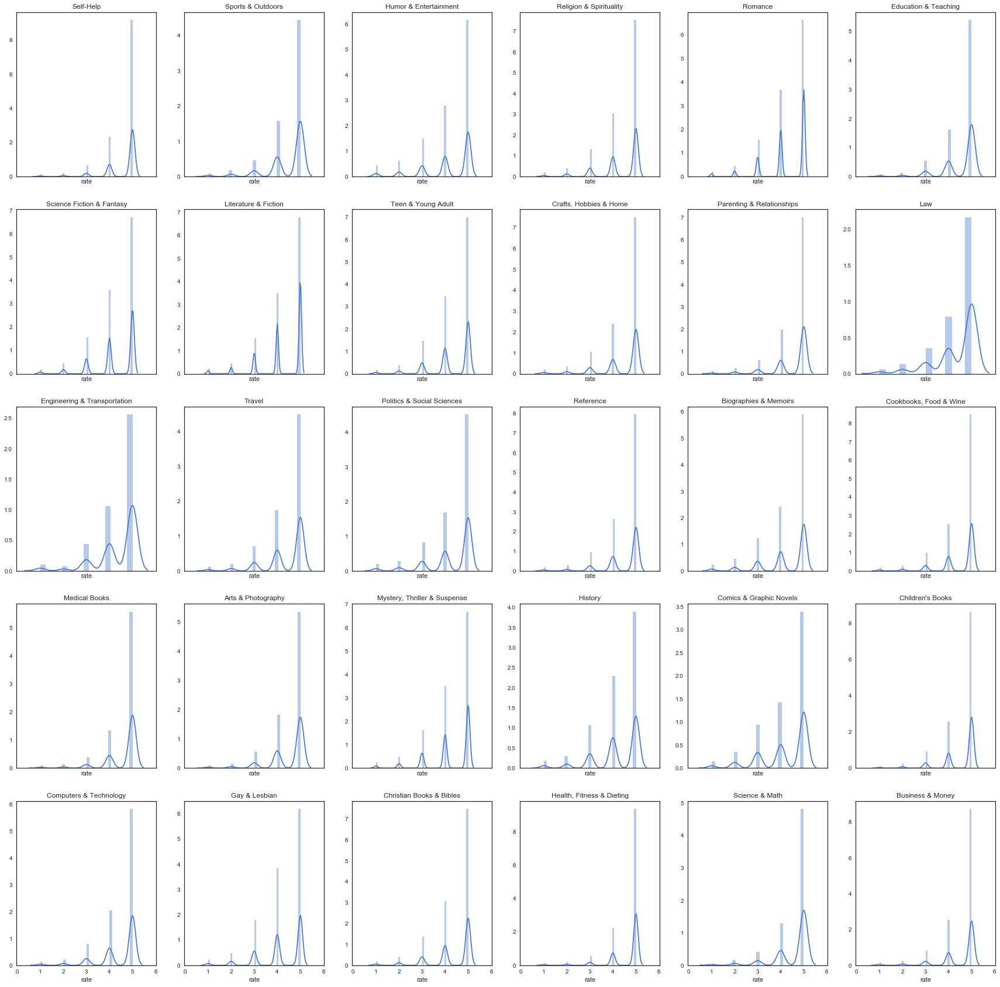

In [86]:
f, axes = plt.subplots(5, 6, figsize=(30,30), sharex=True)
sns.set(style="white", palette="muted", color_codes=True)
for i in range(5):
    for j in range(6):
        axes[i,j].set_title(categories_matrix[i,j])
        sns.distplot(df_kindle_book_review_with_pred[df_kindle_book_review_with_pred['category'] == categories_matrix[i,j]]['rate'], color="b",ax=axes[i,j])
f.savefig("rate_score_dist_by_category.png")

#### Distribution of difference between real and predictive rating score by category

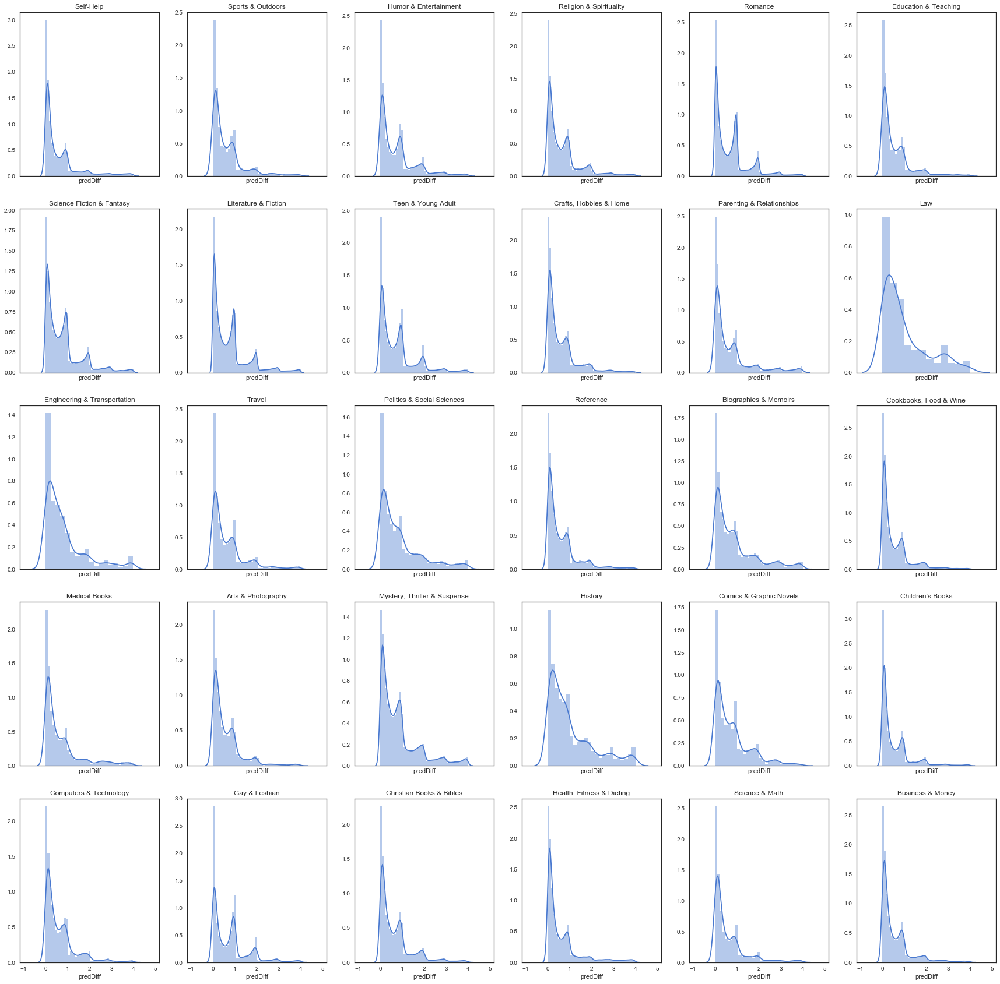

In [87]:
f, axes = plt.subplots(5, 6, figsize=(30,30), sharex=True)
sns.set(style="white", palette="muted", color_codes=True)
for i in range(5):
    for j in range(6):
        axes[i,j].set_title(categories_matrix[i,j])
        sns.distplot(df_kindle_book_review_with_pred[df_kindle_book_review_with_pred['category'] == categories_matrix[i,j]]['predDiff'], color="b",ax=axes[i,j])
f.savefig("diff_dist_by_category.png")

**Violin/Box plot for real v.s. predictive rating score by category**

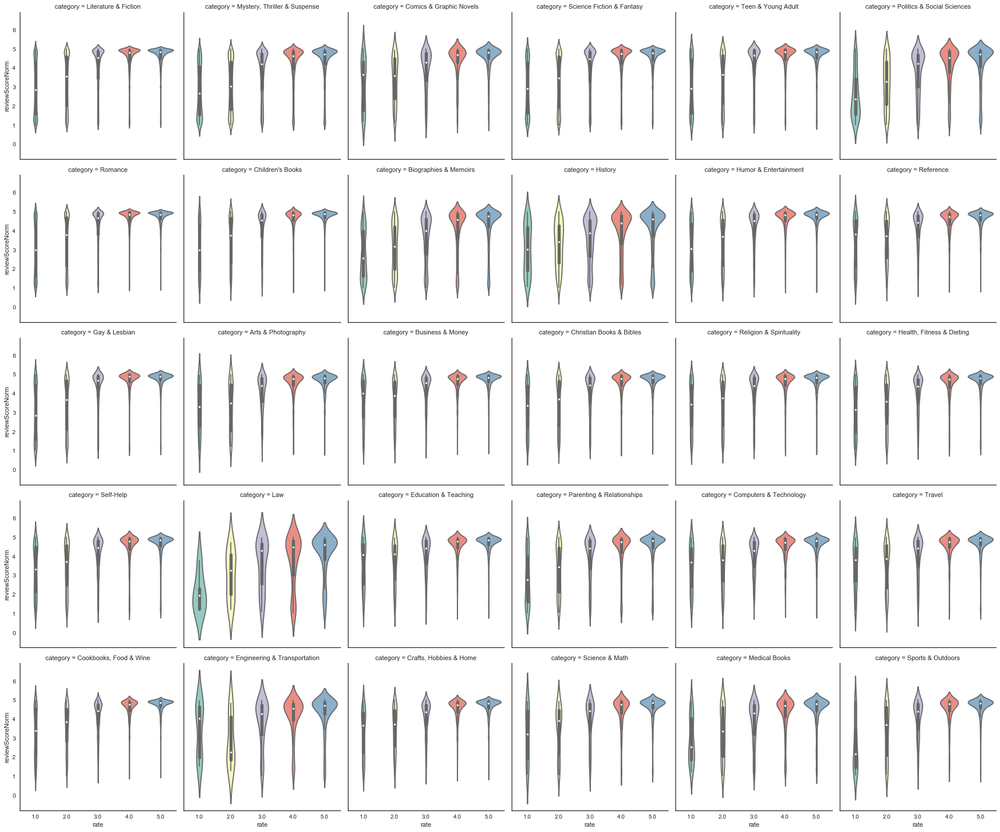

In [88]:
f = sns.factorplot(x='rate', 
               y='reviewScoreNorm', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='violin',
               palette="Set3")
f.savefig("violin_by_category.png")

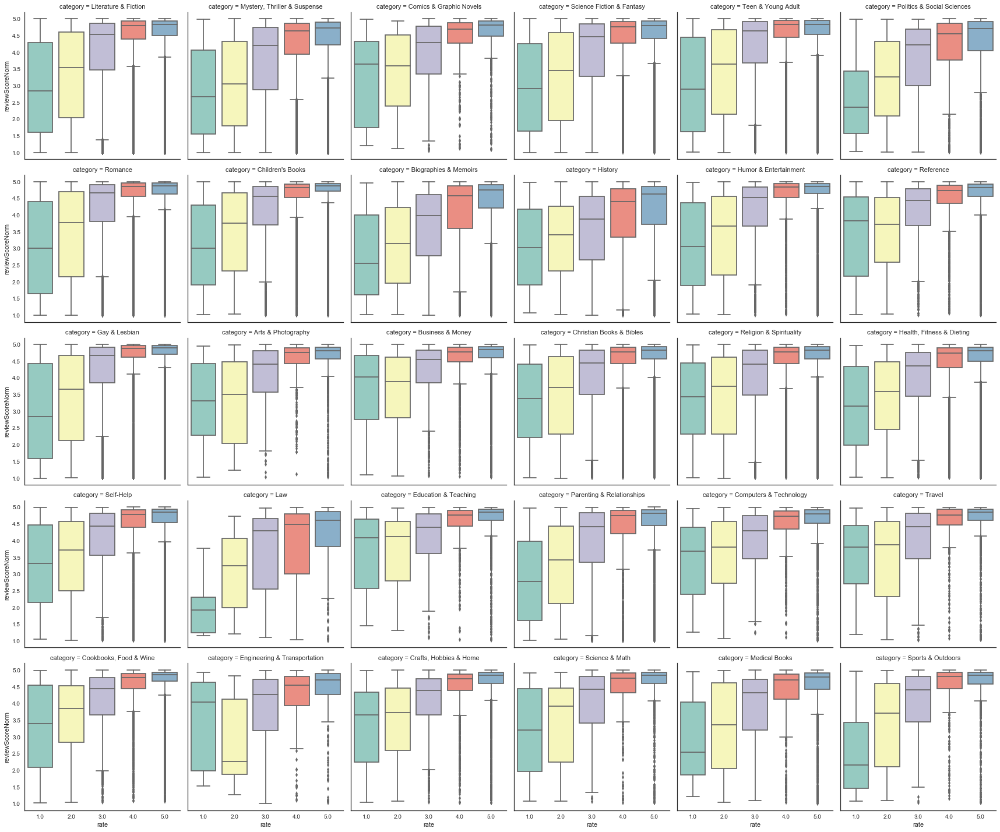

In [89]:
f = sns.factorplot(x='rate', 
               y='reviewScoreNorm', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='box',
               palette="Set3")
f.savefig("box_by_category.png")

**Volin plot for difference by category**

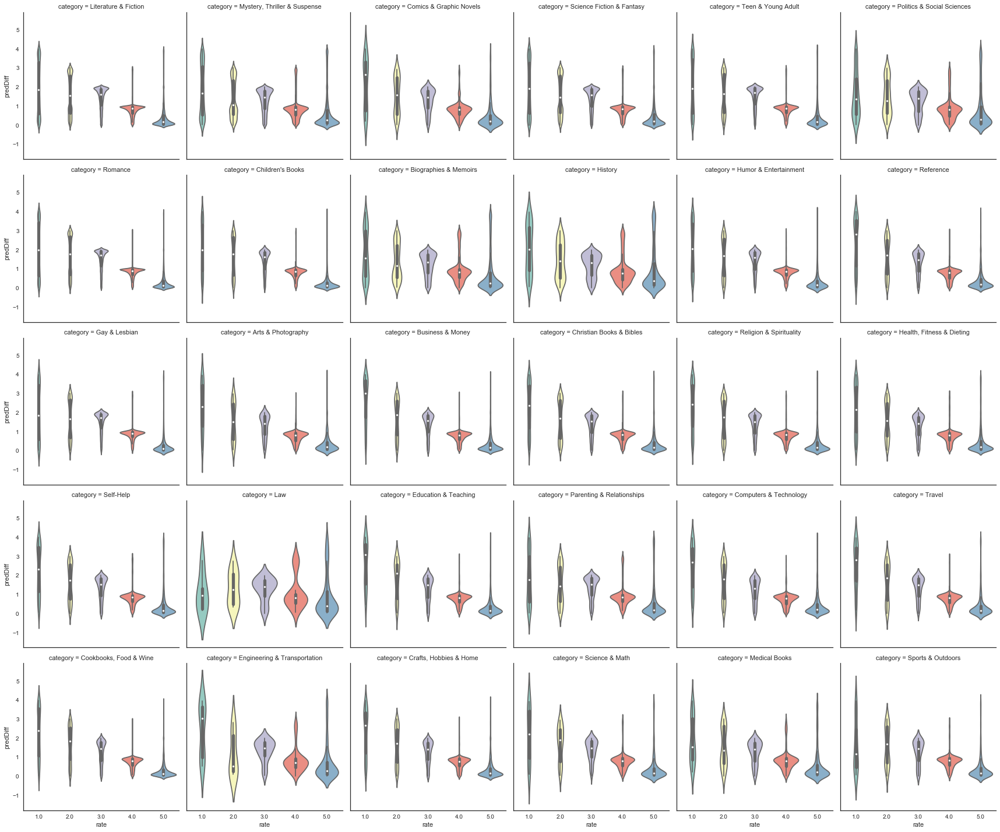

In [90]:
f = sns.factorplot(x='rate', 
               y='predDiff', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='violin',
               palette="Set3")
f.savefig("diff_violin_by_category.png")

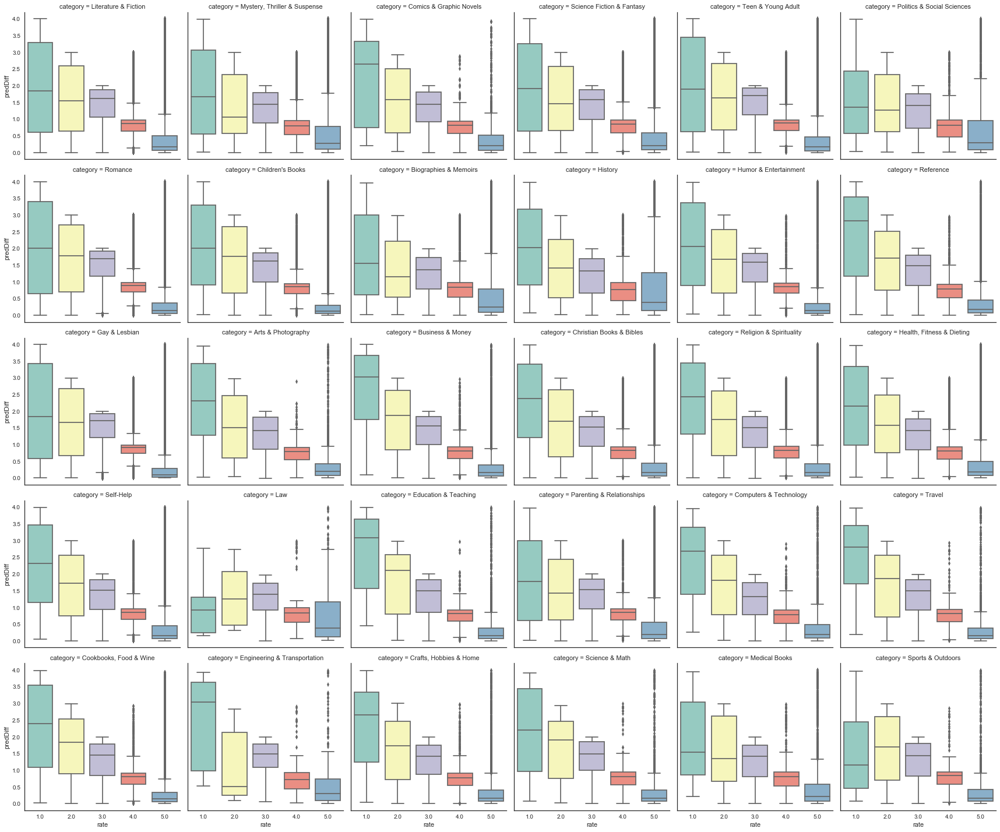

In [91]:
f = sns.factorplot(x='rate', 
               y='predDiff', 
               data=df_kindle_book_review_with_pred.reset_index(), 
               col='category',  
               col_wrap=6,
               kind='box',
               palette="Set3")
f.savefig("diff_box_by_category.png")

**Relationship between average of real and predicted rating by category**

In [92]:
df_re = pd.DataFrame()
df_re['amount'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred['category']])['rate'].count()
df_re['real_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred['category']])['rate'].mean()
df_re['pred_avg'] = df_kindle_book_review_with_pred.groupby([df_kindle_book_review_with_pred['category']])['reviewScoreNorm'].mean()

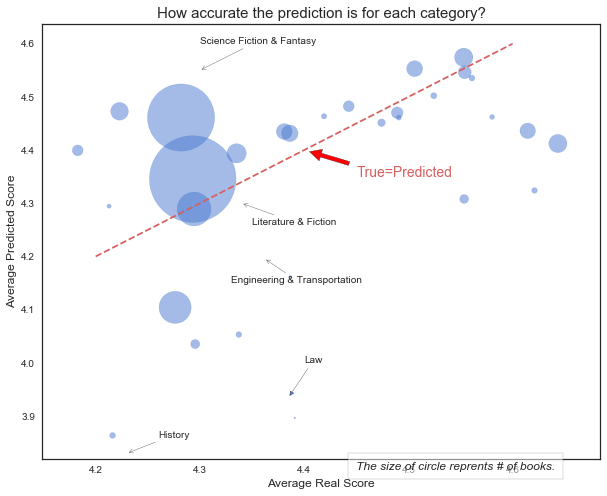

In [93]:
f, ax = plt.subplots(1, 1, figsize=(10,8))
ax.scatter(df_re.real_avg, df_re.pred_avg, s=df_re.amount/100, alpha=0.5)
ax.set_xlabel('Average Real Score',fontdict=dict(size=12))
ax.set_ylabel('Average Predicted Score',fontdict=dict(size=12))
ax.set_title('How accurate the prediction is for each category?',fontdict=dict(size=15))

ax.text(4.45, 3.8, 'The size of circle reprents # of books.', style='oblique', fontdict=dict(size=12),
        bbox={'facecolor':'white', 'alpha':0.5, 'pad':8})


# Plot the line where True Score = Predicted Score
ax.plot([4.2,4.6],[4.2,4.6],'r--')
ax.annotate('True=Predicted', size=14, color='r', xy=(4.4, 4.4), xytext=(4.45, 4.35),
            arrowprops=dict(facecolor='red',shrink=0.1))

# Annotate several categories whose difference between true and predicted scores is huge

# Two categories of the smallest amount
# Law
ax.annotate('Law', size=10, xy=(4.385,3.935), xytext=(4.4, 4),
            arrowprops=dict(arrowstyle='-|>'))

# Engineering & Transportation
ax.annotate('Engineering & Transportation', size=10, xy=(4.362,4.196), xytext=(4.33, 4.15),
            arrowprops=dict(arrowstyle='->'))

# Two categories of the largest amount
# Literature & Fiction
ax.annotate('Literature & Fiction', size=10, xy=(4.34,4.3), xytext=(4.35, 4.26),
            arrowprops=dict(arrowstyle='->'))

# Science Fiction & Fantasy
ax.annotate('Science Fiction & Fantasy', size=10, xy=(4.3,4.55), xytext=(4.3, 4.6),
            arrowprops=dict(arrowstyle='->'))

# History
ax.annotate('History', size=10, xy=(4.23,3.83), xytext=(4.26, 3.86),
            arrowprops=dict(arrowstyle='->'))

plt.show()
f.savefig("pred_accuracy.png")

**What we have known so far:**
1. We give each review text a sentiment score and normalize it to our 1-5 score as our predicted score, and then we compare it with the real score.
2. From the **Volin/Box plot for real v.s. predictive rating score by category**, we can get that for each category high real score will get a high predicted score. In other words, if someone gives high rate then his/her review is more like to have lots of positive words.
3. From the **Volin/Box plot for difference by category**, we can see the difference between our predicted score and real score is small is the real score is high. But if real score is low, like 1 or 2, then the difference is significant. That is quite interesting and **we can do some extra study on words people use for low score**! One possible reason is the review of people who give low score may not be that *negative* and the words are more netural.
4. From the **Scatterplot**, we see that predicted scores of thoes categories of large amount is more accurate which seems to make sense because we have a larger amount of samples.

#### 3.2.2 More basic study on rating score itself

### 3.4 Review text analysis

In this part, we divide the Review according to Time, Category and Rate, and then analyse the keywords, the length of reviews, the propotion of speech for each group.

**Defination of key word**: 

The most frequently used words (Only **Nouns**, **Adverb**, **Verb** and **Adjectives**) in the reviews.

**Method of finding**:

That's where Natural Language Processing comes into play.

We are going to use [Spacy](https://spacy.io/usage/) to find Nouns, Verb, Adver and Adjectives and calulate the frequency of words in the lists of text.

2. Transform all forms of words into original form, e.g. transform 'went' and 'gone' into 'go' using `.lemma_` from Spacy.
3. Select only nouns, verbs, adverbs, and adjectives using `.pos_` from Spacy.
4. Diveded the selected words into noun group, verb group, adverb group and adjective group in order to select the keywords for each     parts of speech.

**Visulization**:

We choose to use [Word Cloud](https://en.wikipedia.org/wiki/Tag_cloud) for visualization. 

As defined in Wikipedia:

>A tag cloud (word cloud, or weighted list in visual design) is a visual representation of text data, typically used to depict keyword metadata (tags) on websites, or to visualize free form text.

>This format is useful for quickly perceiving the most prominent terms and for locating a term alphabetically to determine its relative prominence.

And [wordcloud](https://github.com/amueller/word_cloud) is a little word cloud generator in Python.

In [3]:
from wordcloud import WordCloud,ImageColorGenerator,STOPWORDS
from scipy.misc import imread
import spacy
from collections import Counter
from ipywidgets import *
import seaborn as sns
import pandas as pd 
nlp = spacy.load('en_core_web_sm')

Define the function about words processing.

Function `textprocessing` is used to   
1. Combine all the reviews of each group into one text      
2. Convert an inflected form into a lemma   
3. Select noun,adjective and adverb as the data used to creat wordclound 
4. Divide the words into four group: noun,verb, adverb, adjective

In [4]:
def textprocessing(x):
    X = []
    for i in range (len(x)):
        m = len(x[i])
        review = [str(word) for word in x[i].reviewText.values]
        content = " ".join(review)
        X.append(content)
    word_type = ['NOUN','ADJ','ADV'] 
    Wordcloud=[]
    Nouns = []
    Verbs = []
    Adjs = []
    Advs = []
    for i in range(len(X)):
        doc = nlp(X[i][:40000])
        Y =[]
        nouns = []
        verbs = []
        advs = []
        adjs = []
        for word_list in doc:
            word_lemma = word_list.lemma_
            for w_type in word_type:
                if word_list.pos_==w_type:
                    Y.append(word_lemma)
            if word_list.pos_ == "NOUN":
                nouns.append(word_list.lemma_)
            if word_list.pos_ == "VERB":
                verbs.append(word_list.lemma_)
            if word_list.pos_ == "ADV":
                advs.append(word_list.lemma_)
            if word_list.pos_ == "ADJ":
                adjs.append(word_list.lemma_)
        Nouns.append(nouns)
        Verbs.append(verbs)
        Adjs.append(adjs)
        Advs.append(advs)
        z =" ".join(list(Y))
        Wordcloud.append(z)
    return Wordcloud,Nouns,Verbs,Adjs,Advs

Function `add_words_type` is used to   
1. compute the number of "!","?" and the number of sentences used in each review.   
2. compute the number of noun, verb, adverb, adjective in each review
3. add the result mentioned above as new columns into original data.

In [5]:
def add_words_type(x,m):
    Noun= [] 
    Verb = [] 
    Adj = []
    Adv = []
    Signal_ex = []
    Signal_qu = []
    Sentence = []
    for reviews in x[:m]['reviewText']:
        counts = {}
        signal_ex = reviews.count('!')
        signal_qu = reviews.count('?')
        sentence_num = reviews.count('.')+signal_qu+signal_ex-reviews.count('...')*2
        doc_rate = nlp(reviews)
        counts = Counter(tag.pos_ for tag in doc_rate)    
        Noun.append(counts['NOUN'])
        Verb.append(counts['VERB'])
        Adj.append(counts['ADJ'])
        Adv.append(counts['ADV'])
        Signal_ex.append(signal_ex)
        Signal_qu.append(signal_qu)
        Sentence.append(sentence_num)
    X= x[:m]   
    X['Sentence']= Sentence
    X['Signal_ex']=Signal_ex
    X['Signal_qu']=Signal_qu
    X['Noun']=Noun
    X['Verb']=Verb
    X['Adv']=Adv
    X['Adj']=Adj
    return X

In [6]:
df_kindle_book = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')
df_kindle_sr = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')

# divided by category      
1. Using function `groupby` divide the data by **Category**
2. Using **dictionary** to store the data

In [7]:
data_book=[]
key = []
for name, group in df_kindle_book.groupby("category"):
    key.append(name)
    data_book.append(group)

1. Computer the number of reviews of each category and then plot the distribute of them.
2. Since the difference in length is too big, so we plot the **log** of length

In [8]:
length = [len(category) for category in data_book]
layout = go.Layout(
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
        type='log'
    ),
)
data = [go.Bar(
            x=key,
            y=length,
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5']
            ),
        )]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='year_review_number_barchart1',layout=layout)

**Analysis**
1. Acoording to the histogram we can find that different categories have diffrent number of reviews,
  Literature & Fiction and Romance book have the largest number of reviews, which are about 2000 times than smallest numer of reviews.
2. The number of reviews can reflect the extent of people's love of books, which means most people are likely to read Literature & Fiction and Romance ,and most people(**just like me**) don't like to read books about Engineering & Transportation  and Law.

**Select Categoriy**
1. Since each book can belong to several categories, so choosing some categories with less overlap will be benificial for us to analyse and compare with each category.   
2. we fistly compute the number of duplicate reviews between different categories using function `intersection`.
3. Then we use **heatmap** to show the confusion matrix of categories, and since the values of confusion matrix are huge different with each other, we use the **log** values to draw heatmap.

In [20]:
repeat = {}
m = len(key)
matrix = np.zeros([m,m])
for i in range(0,m):
    for j in range(0,m):
        count = 0 
        a = data_book[i]['summary'].values
        b = data_book[j]['summary'].values
        count = len(list(set(a).intersection(set(b))))
        matrix[i][j] = count
        repeat[key[i]+' VS '+key[j]]=count
matrix_log = np.log(matrix)
layout = go.Layout(
    xaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis = dict(
        tickangle = 30,
        tickfont = dict(
            size = 10
        )
    ),
)        
        
trace = [go.Heatmap(z=matrix_log.tolist(),
                    x=key,
                    y=key,
                  )]
fig = go.Figure(data=trace, layout=layout)
py.iplot(fig, filename='confusion_matirxs_heatmap',layout=layout)

**Analysis**   
According to the **heatmap** we draw above, we manually select six categories which have only small duplicated reviews number with each others in the premise of retaining as much reviews as possible. 

And then we also show the duplicated reviews confution matrix between selected categories through **heatmap**.

In [51]:
Repeat = {}
#key = ['Literature & Fiction','Business & Money','Crafts, Hobbies & Home','Health, Fitness & Dieting','Biographies & Memoirs']#self]
keys = ['Romance',"Children's Books",'Business & Money','Biographies & Memoirs','Crafts, Hobbies & Home','Health, Fitness & Dieting']   
n= len(keys)
Matrix = np.zeros([n,n])
for i in range(0,n):
    for j in range(0,n):
        count = 0 
        a = data_book[i]['summary'].values
        b = data_book[j]['summary'].values
        count = len(list(set(a).intersection(set(b))))
        Matrix[i][j] = int(count)
        Repeat[keys[i]+' VS '+keys[j]]=count
Matrix_log = np.log(Matrix)        
layout = go.Layout(
    xaxis = dict(
        tickangle = 6,
        tickfont = dict(
            size = 10
        )
    ),
    yaxis = dict(
        tickangle = 6,
        tickfont = dict(
            size = 10
        )
    ),
)        
        
trace = [go.Heatmap(z=Matrix_log.tolist(),
                   x=keys,
                   y=keys,
                  )]
fig = go.Figure(data=trace, layout=layout)
py.iplot(fig, filename='confusion_matirx_heatmap',layout=layout)

## **Analysis for confusion matrix**
1. In order to better show the number of repetitions, we draw the **log** values for confusion matrix.
2. We already know that the number reviews of **Romance** is 281000, **Children's Book** is 28000, **Business & Money** is 14000,**Biographies & Memoirs** is 7000,**Crafts,Hobbies & Home** is 10000 and **Health,Fitness & Dieting** is 26000, so through the confusion matrix, we can find that compared with total reviews of each category, the duplicated reviews can be ignore, whihc means the categories we selected are reasonable. 

According to the chosen categories we select the corresponding data from original data.

In [26]:
df_book_class = df_kindle_book[df_kindle_book['category'].isin(key)]
data_book_class= []
category=[]
for name, group in df_book_class.groupby("category"):
    data_book_class.append(group)
    category.append(name)

1. Using `textprocessing` function to process the data we chosed   
2. Using `WordCloud` function from **wordcloud** library to creat wordcloud for each category.

In [27]:
review_book_class,noun_class,verb_class,adj_class,adv_class = textprocessing(data_book_class)

del_word = ['book','story','will','one','two','three','four','five','want','make','take','reader','PRON']
for word in del_word:
    stopword = STOPWORDS.add(word)
picture = imread('cloudPrint.png')
def plotworld(Category):
    fig = plt.figure(figsize=(12,12))
    ax = fig.add_subplot(1,1,1)    
    i = category.index(Category)
    wordcloud = WordCloud(background_color='white',mask=picture,colormap="Set2_r",stopwords=stopword,max_words=2000,max_font_size=400,random_state=43).generate(review_book_class[i])
    wordcloud.to_file(Category+'.png')
    plt.imshow(wordcloud)
    plt.axis("off")
interact(plotworld,Category=category)

interactive(children=(Dropdown(description='Category', options=('Arts & Photography', 'Biographies & Memoirs', 'Business & Money', "Children's Books", 'Christian Books & Bibles', 'Comics & Graphic Novels', 'Computers & Technology', 'Cookbooks, Food & Wine', 'Crafts, Hobbies & Home', 'Education & Teaching', 'Engineering & Transportation', 'Gay & Lesbian', 'Health, Fitness & Dieting', 'History', 'Humor & Entertainment', 'Law', 'Literature & Fiction', 'Medical Books', 'Mystery, Thriller & Suspense', 'Parenting & Relationships', 'Politics & Social Sciences', 'Reference', 'Religion & Spirituality', 'Romance', 'Science & Math', 'Science Fiction & Fantasy', 'Self-Help', 'Sports & Outdoors', 'Teen & Young Adult', 'Travel'), value='Arts & Photography'), Output()), _dom_classes=('widget-interact',))

<function __main__.plotworld>

**Analysis**
1. for **Arts & Photography**, we can find that the words **author,business,music** are used more frequently, which means when choosing books about Art & Photography, people are more like concerned about the 'author' about the book, the relationship between art and business, and people are also more likely to choose books about music.
2. The same in the **Cookbooks,Food & Wine**, people are more likely to use **recipe,family,healthy** in the reviews, and this implies that people are more care about the healthy diet habit, and they always buy the books for finding favorite recipe for family.

# divided by time 

1. Dropout the duplicated review in different category
2. Setting `unixReviewTime` as index in order to divide data by time. 
3. Using `groupby` to group the data and store each group in the list.
4. Adding the length of each review to the original data.
5. Drawing a bar plot to show the number of review in each year.

In [28]:
df_book = df_kindle_book.drop_duplicates(["reviewText"])
book = df_book.set_index('unixReviewTime')
data_book_time= []
for name, group in book.groupby(pd.TimeGrouper(freq='A')):
    data_book_time.append(group)

In [29]:
for i in range(0,len(data_book_time)):
    length = []
    for j in range(0,len(data_book_time[i])):
        length.append(len(data_book_time[i]['reviewText'].iloc[j].split()))
    data_book_time[i]['length of review']=length  

In [36]:
length_time = {}
for i in range(0,len(data_book_time)):
    t = str(i + 2000)
    length_time[t] = len(data_book_time[i])

In [53]:
layout = go.Layout(
    title='The number of reviews in each year',
    xaxis = dict(
        
        tickfont = dict(
            size = 10
        )
    ),
    yaxis=dict(
        type='log'
    ),
)
data = [go.Bar(
            x=list(length_time.keys()),
            y=list(length_time.values()),
            marker=dict(
                color=['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5','#e5d8bd','#fddaec','#f2f2f2','#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#c7eae5']
            ),
        )]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='year_review_number_barchart2',layout=layout)

**Analysis**
1. It is obviouly that the number of reviews has grown exponentially since 2002.
2. According to the picture above we can conclude that the number of people buying books online become large as time goes by and people are likely to recognize the importance of reviews for books and be more active in writing reviews,

1. Using `textprocessing` function to process the data we chosed   
2. Using `WordCloud` function from **wordcloud** library to creat wordcloud for every year.

In [54]:
review_book_time,noun_time,verb_time,adj_time,adv_time= textprocessing(data_book_time)

In [55]:
review_book_time,noun_time,verb_time,adj_time,adv_time= textprocessing(data_book_time)

picture = imread('cloudPrint.png')
from ipywidgets import *
def plotworld(year):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(1,1,1)    
    wordcloud = WordCloud(background_color='white',mask=picture,colormap="Set2_r",stopwords=stopword,max_words=2000,max_font_size=400,random_state=43).generate(review_book_time[year-2000])
    wordcloud.to_file(str(year)+'.png')
    plt.imshow(wordcloud)
    plt.axis("off")

interact(plotworld,year=(2000,2014,1))

interactive(children=(IntSlider(value=2007, description='year', max=2014, min=2000), Output()), _dom_classes=('widget-interact',))

<function __main__.plotworld>

**Analysis**
1. We believe that reviews not only can reflect the content and people's feeling of books, but also can reflect the most popular words of each year and the type of books that readers like to read every year.
2. We may infer that the the popular words in 2014 are **good, character, new** and so on, and meanwhile we can conclude that people are more likely to read **Romance**(keywords: ***romance,love*), Arts & Photography**(keywords: **author**), **Literature & Fiction**(keywords:**character**) in 2014.

# divided by rate

1. Using `groupby` function to divide the data into 5 groups by rate.
2. Compute the lenth of each review and add the length feature to the original data.

In [56]:
data_book_rate=[]
rate = []
for name, group in df_book.groupby("rate"):
    data_book_rate.append(group)
    rate.append(name)

for i in range(0,len(data_book_rate)):
    length = []
    for j in range(0,len(data_book_rate[i])):
        length.append(len(data_book_rate[i]['reviewText'].iloc[j].split()))
    data_book_rate[i]['length of review']=length  

1. Using `textprocessing` function to process the data we chosed   
2. Using `WordCloud` function from **wordcloud** library to creat wordcloud for each Rate.

In [58]:
review_book_rate,noun_rate,verb_rate,adj_rate,adv_rate= textprocessing(data_book_rate)

picture = imread('cloudPrint.png')
def plotworld(Rate):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(1,1,1)    
    wordcloud = WordCloud(background_color='white',mask=picture,colormap="Set2_r",stopwords=stopword,max_words=2000,max_font_size=400,random_state=43).generate(review_book_rate[Rate-1])
    wordcloud.to_file(str(Rate)+'.png')
    plt.imshow(wordcloud)
    plt.axis("off")
interact(plotworld,Rate=(1,5,1))

interactive(children=(IntSlider(value=3, description='Rate', max=5, min=1), Output()), _dom_classes=('widget-interact',))

<function __main__.plotworld>

**Analysis**
1. Although the word **good**  are used in every rate, but it is delight to find that the number of **good** are increased as rate improve.
2. We can also infer that the rate distribution of each category according to the wordcloud. For example, we can find that **character** are more remarkable in rate 1,2and 3 than rate 4 and 5, which means in rate 1,2 and 3 ,**Literature & Fiction** occupied most of the reviews but not in rate 4 and 5.

Using `add_words_type` function to 
1. compute the number of "!","?" and sentences.   
2. compute the number of noun, verb, adverb, adjective in each review
3. add the result as new columns into original data

In [59]:
data_book_rated=[]
m = 10000
for i in range(0,len(data_book_rate)):
    Data_book_rated = add_words_type(data_book_rate[i],m)
    data_book_rated.append(Data_book_rated)

In [ ]:
noun_freq = []
verb_freq = []
adv_freq = []
adj_freq = []
for i in range(0,len(noun_rate)):
    noun_freq.append(Counter(noun_rate[i]))
    verb_freq.append(Counter(verb_rate[i]))
    adv_freq.append(Counter(adv_rate[i]))
    adj_freq.append(Counter(adj_rate[i]))

In [60]:
data_book_rated[0].to_pickle('data_book_rate1')
data_book_rated[1].to_pickle('data_book_rate2')
data_book_rated[2].to_pickle('data_book_rate3')
data_book_rated[3].to_pickle('data_book_rate4')
data_book_rated[4].to_pickle('data_book_rate5')


### 3.5 Review text analysis -- Style of review for each ratings:

In this part, we are going to study the style of review for each ratings. 

Properties of reviews to be or could be studied:
- Length of reviews
- Key word study and word cloud based on 3.4 
- Comprehensive sentiment analysis based on 3.2 using the sentiment score

### 3.6 Review text analysis -- Relationship between text and ratings/category
In this part, instead of using `SentimentIntensityAnalyzer`, we want to find another way to represents review text and find the relationship between text and the rating score, and one of followings is enough we think:

1. [Spectral Graph Theory](https://en.wikipedia.org/wiki/Spectral_graph_theory)
2. Machine Learning

#### Based mainly on Spectral Graph Theory

- **General Methods**:
    1. Vectorize text of reviews as the traing data.
    2. Use rating/category as the label for each observation.
    3. Generate the similarity matrix.
    4. Implement [Spectral Clustering](https://arxiv.org/abs/0711.0189) methods with k-Means algorithm.


- **We have done for this part so far**:
    1. Knowledge about the spectral clustering methods.
    2. Use TF-IDF to vectorize the text.
    3. Calculate the distance between each vector as the similarity matrix.
    4. Implement spectral clustering algorithm.
    5. But we cannot see any clusters.


- **Problems we are facing**:

    How to reasonably vectorize text and thus have good clustering result? That's what we are going to figure it out.

#### Based mainly on Machine Learning

- **General Methods**:
    1. Vectorize text of reviews as the traing data.
    2. Use rating/category as the label for each observation.
    3. Implement classifer methods.


- **Problems we are facing**:

    The same as above: How to reasonably vectorize text and thus have good classification result?

In [ ]:
# Since the result is not good, we don't upload code for this part.

### 3.7 Generate  automatically summary of review
In this part, we are going to generate automatically summary of review based on the text of review and/or the ratings.

**Method 1 -- Based on Ratings:**
1. Generate a vocabulary dictionary: For each ratings, find the key word based on the part of speech, like noun or adjective.
2. Build our own sentence based on the ratings one reviewer give.

**Method 2 -- Based on Reviews:**
1. Text cleaning: Remove unwanted characters and handle word embeddings
2. Design and build one neural network.
3. Train it based on reviews and corresponding summary in the dataset.


In [2]:
df_general = pd.read_pickle('pickleDataNew/kindle_book_review_with_pred_diff.pkl')

In [3]:
df_general

,asin,rate,price,summary,reviewText,unixReviewTime,reviewScore,reviewScoreNorm,predDiff
category,,,,,,,,,
Literature & Fiction,B000F83SZQ,5.0,0.00,Nice vintage story,I enjoy vintage books and movies so I enjoyed ...,2014-05-05,0.8698,4.67450,0.32550
"Mystery, Thriller & Suspense",B000F83SZQ,5.0,0.00,Nice vintage story,I enjoy vintage books and movies so I enjoyed ...,2014-05-05,0.8698,4.67450,0.32550
Literature & Fiction,B000F83SZQ,4.0,0.00,Different...,This book is a reissue of an old one; the auth...,2014-01-06,0.8622,4.65550,0.65550
"Mystery, Thriller & Suspense",B000F83SZQ,4.0,0.00,Different...,This book is a reissue of an old one; the auth...,2014-01-06,0.8622,4.65550,0.65550
Literature & Fiction,B000F83SZQ,4.0,0.00,Oldie,This was a fairly interesting read. It had ol...,2014-04-04,0.9501,4.87525,0.87525
"Mystery, Thriller & Suspense",B000F83SZQ,4.0,0.00,Oldie,This was a fairly interesting read. It had ol...,2014-04-04,0.9501,4.87525,0.87525
Literature & Fiction,B000F83SZQ,5.0,0.00,I really liked it.,I'd never read any of the Amy Brewster mysteri...,2014-02-19,0.0000,2.50000,2.50000
"Mystery, Thriller & Suspense",B000F83SZQ,5.0,0.00,I really liked it.,I'd never read any of the Amy Brewster mysteri...,2014-02-19,0.0000,2.50000,2.50000
Literature & Fiction,B000F83SZQ,3.0,0.00,Period Mystery,"If you like period pieces - clothing, lingo, y...",2014-03-19,0.6908,4.22700,1.22700


In [4]:
df_short_read = pd.read_pickle('pickleDataNew/kindle_short_read_review.pkl')

In [5]:
df_short_read

,category,rate,price,summary,reviewText,unixReviewTime
asin,,,,,,
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,An interesting short story.,Really shouldn't have Han Solo on the cover as...,2014-02-15
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Short story featuring everyone's favorite Wookiee,Originally published as an e-book coinciding w...,2008-08-25
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,Great,This book was a good idea. I have always wante...,2013-04-01
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Another read,Great short story. It gives a little more insi...,2014-01-02
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Love It,I love anything with Chewbacca in it. Him and...,2013-10-11
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,Star Wars: A Forest Apart,"A great little chapter to read on my Kindle, b...",2009-04-16
B000FBFMVG,Two hours or more (65-100 pages),5.0,1.99,my collection,I love the stories with Chewie in them! this e...,2014-01-27
B000FBFMVG,Two hours or more (65-100 pages),4.0,1.99,Enjoyable But...,I'm not really sure where it actually fits int...,2012-01-14
B000FBFMVG,Two hours or more (65-100 pages),3.0,1.99,A Good Quick Read,"I really do enjoy Troy Denning's work, I want ...",2013-04-07


In [9]:
df_general[df_general['asin'] == 'B000JMKNQ0']

,asin,rate,price,summary,reviewText,unixReviewTime,reviewScore,reviewScoreNorm,predDiff
category,,,,,,,,,
Literature & Fiction,B000JMKNQ0,4.0,7.99,Worthwhile addition to the New Jedi Order,Karen Traviss was noted during her time as a S...,2012-03-15,0.9707,4.92675,0.92675
Science Fiction & Fantasy,B000JMKNQ0,4.0,7.99,Worthwhile addition to the New Jedi Order,Karen Traviss was noted during her time as a S...,2012-03-15,0.9707,4.92675,0.92675
Science Fiction & Fantasy,B000JMKNQ0,4.0,7.99,Worthwhile addition to the New Jedi Order,Karen Traviss was noted during her time as a S...,2012-03-15,0.9707,4.92675,0.92675
Literature & Fiction,B000JMKNQ0,5.0,7.99,Another reader,Good read. I enjoyed the look into another sid...,2014-01-02,0.7351,4.33775,0.66225
Science Fiction & Fantasy,B000JMKNQ0,5.0,7.99,Another reader,Good read. I enjoyed the look into another sid...,2014-01-02,0.7351,4.33775,0.66225
Science Fiction & Fantasy,B000JMKNQ0,5.0,7.99,Another reader,Good read. I enjoyed the look into another sid...,2014-01-02,0.7351,4.33775,0.66225
Literature & Fiction,B000JMKNQ0,5.0,7.99,Fetts the man,"Boba Fett sort of gets screwed, but turns it a...",2013-10-11,-0.0534,2.36650,2.63350
Science Fiction & Fantasy,B000JMKNQ0,5.0,7.99,Fetts the man,"Boba Fett sort of gets screwed, but turns it a...",2013-10-11,-0.0534,2.36650,2.63350
Science Fiction & Fantasy,B000JMKNQ0,5.0,7.99,Fetts the man,"Boba Fett sort of gets screwed, but turns it a...",2013-10-11,-0.0534,2.36650,2.63350
